In [1]:
# !pip freeze > requirements.txt

In [2]:
# import os
# import matplotlib.pyplot as plt

In [3]:
# ds = '/kaggle/working/plantvillage_split_augmented/val'

In [4]:
# class_counts = {}
# for class_name in os.listdir(ds):
#     class_path = os.path.join(ds, class_name)
#     if os.path.isdir(class_path):
#         num_images = len(os.listdir(class_path))
#         class_counts[class_name] = num_images

In [5]:
# class_counts = dict(sorted(class_counts.items(), key=lambda x: x[1], reverse=True))

In [6]:
# unwanted = ["Potato", "Pepper"]
# for name in list(class_counts.keys()):
#     if any(plant in name for plant in unwanted):
#         class_counts.pop(name)

In [7]:
# for cls, count in class_counts.items():
#     print(f'{cls}: {count} images')

# **Class Distribution**

In [8]:
# plt.figure(figsize=(15, 6))
# plt.bar(class_counts.keys(), class_counts.values(), color='forestgreen')
# plt.xticks(rotation=90)
# plt.title('Number of Images per Class')
# plt.xlabel('Class Name')
# plt.ylabel('Image Count')
# plt.tight_layout()
# plt.show()

# **Image Characteristics**

In [9]:
# import cv2
# import numpy as np

# from collections import Counter

In [10]:
# image_shapes = []
# color_modes = []
# file_extensions = []

In [11]:
# for root, _, files in os.walk(ds):
#     for file in files:
#         if file.endswith(('.jpg', '.jpeg', '.png')):
#             file_path = os.path.join(root, file)
#             img = cv2.imread(file_path)
#             if img is not None:
#                 # ขนาดภาพ
#                 h, w, c = img.shape
#                 image_shapes.append((w, h))
                
#                 # ช่องสี
#                 color_modes.append("RGB" if c == 3 else "Grayscale")
                
#                 # นามสกุลไฟล์
#                 ext = os.path.splitext(file)[1]
#                 file_extensions.append(ext)


In [12]:
# shape_counts = Counter(image_shapes)
# color_counts = Counter(color_modes)
# ext_counts = Counter(file_extensions)

# print("🔍 Image Sizes:")
# for shape, count in shape_counts.items():
#     print(f"{shape}: {count} images")

# print("\n🎨 Color Modes:")
# for mode, count in color_counts.items():
#     print(f"{mode}: {count} images")

# print("\n🖼️ File Extensions:")
# for ext, count in ext_counts.items():
#     print(f"{ext}: {count} images")

In [13]:
# widths = [w for w, h in image_shapes]
# heights = [h for w, h in image_shapes]

In [14]:
# plt.figure(figsize=(12, 5))
# plt.hist(widths, bins=30, alpha=0.6, label='Widths')
# plt.hist(heights, bins=30, alpha=0.6, label='Heights')
# plt.legend()
# plt.title("Distribution of Image Dimensions")
# plt.xlabel("Pixels")
# plt.ylabel("Image Count")
# plt.grid(True)
# plt.tight_layout()
# plt.show()

# **Data Quality**

In [15]:
# import os
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt
# from tqdm import tqdm
# from PIL import Image
# import warnings
# warnings.filterwarnings('ignore')

In [16]:
# blur_scores = []
# dark_scores = []
# noise_scores = []
# bad_images = []
# blurry_images_sample = []
# dark_images_sample = []

In [17]:
# def is_blurry(img, threshold=100.0):
#     gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#     lap_var = cv2.Laplacian(gray, cv2.CV_64F)
#     return lap_var < threshold, lap_var

In [18]:
# def is_dark(image, threshold=50):
#     gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
#     mean_brightness = np.mean(gray)
#     return mean_brightness < threshold, mean_brightness

In [19]:
# def estimate_noise(image):
#     gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
#     noise = np.std(gray)
#     return noise

In [20]:
# for root, dirs, files in os.walk(ds):
#     if 'Potato' in root or 'Pepper' in root:
#         continue

#     for file in tqdm(files):
#         if file.endswith(('.jpg', '.jpeg', '.png')):
#             path = os.path.join(root, file)
#             img = cv2.imread(path)

#             if img is None:
#                 bad_images.append((path, 'Corrupted'))
#                 continue

#             # Blur detection
#             # blurry, score_blur = is_blurry(img)
#             # blur_scores.append(score_blur)
#             # if blurry:
#             #     bad_images.append((path, f'Blurry: {score_blur:.2f}'))
#             #     if len(blurry_images_sample) < 9:
#             #         blurry_images_sample.append((img, path))

#             # Dark detection
#             dark, score_dark = is_dark(img)
#             dark_scores.append(score_dark)
#             if dark:
#                 bad_images.append((path, f'Dark: {score_dark:.2f}'))
#                 if len(dark_images_sample) < 9:
#                     dark_images_sample.append((img, path))

#             # Noise estimation
#             score_noise = estimate_noise(img)
#             noise_scores.append(score_noise)

In [21]:
# plt.figure(figsize=(8, 4))
# plt.hist(blur_scores, bins=30, color='orange', edgecolor='black')
# plt.title('Blur Score Distribution (Laplacian Variance)')
# plt.xlabel('Blur Score')
# plt.ylabel('Number of Images')
# plt.grid(True, linestyle='--', alpha=0.7)
# plt.tight_layout()
# plt.show()

In [22]:
# plt.figure(figsize=(8, 4))
# plt.hist(dark_scores, bins=30, color='blue', edgecolor='black')
# plt.title('Brightness Distribution (Mean Pixel Intensity)')
# plt.xlabel('Brightness Score')
# plt.ylabel('Number of Images')
# plt.grid(True, linestyle='--', alpha=0.7)
# plt.tight_layout()
# plt.show()

In [23]:
# plt.figure(figsize=(8, 4))
# plt.hist(noise_scores, bins=30, color='green', edgecolor='black')
# plt.title('Noise Score Distribution (Std of Grayscale)')
# plt.xlabel('Noise Score')
# plt.ylabel('Number of Images')
# plt.grid(True, linestyle='--', alpha=0.7)
# plt.tight_layout()
# plt.show()

# **Extract Video**

In [24]:
import cv2
import os

In [25]:
video_path = '/kaggle/input/real-world/video_20250521_072827.mp4'
output_path = '/kaggle/working/frames'
os.makedirs(output_path, exist_ok=True)
desired_fps = 15

In [26]:
cap = cv2.VideoCapture(video_path)

video_fps = cap.get(cv2.CAP_PROP_FPS)
frame_interval = int(video_fps / desired_fps)

print(f"Original FPS: {video_fps}, extracting every {frame_interval} frames")

frame_count = 0
saved_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    if frame_count % frame_interval == 0:
        filename = os.path.join(output_path, f'frame_{saved_count:05d}.jpg')
        cv2.imwrite(filename, frame)
        saved_count += 1

    frame_count += 1

cap.release()
print(f"Extracted {saved_count} frames at {desired_fps} FPS.")

Original FPS: 29.602963137737852, extracting every 1 frames
Extracted 1829 frames at 15 FPS.


# **Data Augmentation**

In [27]:
import os
import shutil
import random
from collections import defaultdict
from tqdm import tqdm
from PIL import Image
import torch
from torchvision import transforms
from torchvision.transforms.functional import to_pil_image
from sklearn.model_selection import train_test_split
import cv2 as cv

In [28]:
DATA_DIR = "/kaggle/input/plantdisease/PlantVillage"
SPLIT_DIR = "/kaggle/working/plantvillage_split_augmented"
AUG_THRESHOLD = 4000
EXCLUDED_CLASSES = ['Potato', 'Pepper']
random.seed(152)

In [29]:
augmentation_transform = transforms.Compose([
    # transforms.RandomHorizontalFlip(),
    # transforms.RandomRotation(45),
    # transforms.ColorJitter(brightness=0.4, contrast=0.4, saturation=0.4, hue=0.2),
    transforms.RandomResizedCrop(256, scale=(0.8, 1.0)),
    transforms.ToTensor()
])

In [30]:
def should_skip_class(class_name):
    return any(ex in class_name for ex in EXCLUDED_CLASSES)

class_image_dict = defaultdict(list)
for class_name in os.listdir(DATA_DIR):
    if should_skip_class(class_name):
        continue
    class_path = os.path.join(DATA_DIR, class_name)
    if not os.path.isdir(class_path):
        continue
    for file in os.listdir(class_path):
        if file.lower().endswith(('.jpg', '.jpeg', '.png')):
            class_image_dict[class_name].append(os.path.join(class_path, file))

In [31]:
# Train, Valid, Test
# 70, 15, 15

# for class_name, paths in class_image_dict.items():
#     train_val, test = train_test_split(paths, test_size=0.15, random_state=42)
#     train, val = train_test_split(train_val, test_size=0.1765, random_state=42)  # 0.1765*0.85 ≈ 0.15

#     for subset_name, subset in zip(['train', 'val', 'test'], [train, val, test]):
#         subset_dir = os.path.join(SPLIT_DIR, subset_name, class_name)
#         os.makedirs(subset_dir, exist_ok=True)
#         for img_path in subset:
#             shutil.copy(img_path, os.path.join(subset_dir, os.path.basename(img_path)))




# Train, Valid, Test
# 50%, 25%, 25%

for class_name, paths in class_image_dict.items():
    train, test = train_test_split(paths, test_size=0.5, random_state=42)
    train, val = train_test_split(train, test_size=0.5, random_state=42)  # 50% of the 50% (25% of total)

    for subset_name, subset in zip(['train', 'val', 'test'], [train, val, test]):
        subset_dir = os.path.join(SPLIT_DIR, subset_name, class_name)
        os.makedirs(subset_dir, exist_ok=True)
        for img_path in subset:
            shutil.copy(img_path, os.path.join(subset_dir, os.path.basename(img_path)))

In [32]:
train_dir = os.path.join(SPLIT_DIR, 'train')
for class_name in os.listdir(train_dir):
    class_path = os.path.join(train_dir, class_name)
    images = [f for f in os.listdir(class_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    count = len(images)
    
    if count >= AUG_THRESHOLD or should_skip_class(class_name):
        continue

    print(f"Augmenting class: {class_name} ({count} → {AUG_THRESHOLD})")
    num_to_generate = AUG_THRESHOLD - count

    for i in tqdm(range(num_to_generate), desc=f"Augmenting {class_name}"):
        img_name = random.choice(images)
        img_path = os.path.join(class_path, img_name)
        img = Image.open(img_path).convert("RGB")
        augmented = augmentation_transform(img)

        aug_name = f"aug_{i}_{img_name}"
        aug_path = os.path.join(class_path, aug_name)
        augmented_pil = to_pil_image(augmented)
        augmented_pil.save(aug_path)

print("Split and augmentation completed.")

Augmenting class: Tomato__Tomato_YellowLeaf__Curl_Virus (802 → 4000)


Augmenting Tomato__Tomato_YellowLeaf__Curl_Virus: 100%|██████████| 3198/3198 [00:13<00:00, 230.83it/s]


Augmenting class: Tomato_Septoria_leaf_spot (442 → 4000)


Augmenting Tomato_Septoria_leaf_spot: 100%|██████████| 3558/3558 [00:16<00:00, 219.39it/s]


Augmenting class: Tomato_Bacterial_spot (531 → 4000)


Augmenting Tomato_Bacterial_spot: 100%|██████████| 3469/3469 [00:15<00:00, 230.29it/s]


Augmenting class: Tomato_Late_blight (477 → 4000)


Augmenting Tomato_Late_blight: 100%|██████████| 3523/3523 [00:15<00:00, 222.26it/s]


Augmenting class: Tomato_Early_blight (250 → 4000)


Augmenting Tomato_Early_blight: 100%|██████████| 3750/3750 [00:16<00:00, 229.17it/s]


Augmenting class: Tomato__Target_Spot (351 → 4000)


Augmenting Tomato__Target_Spot: 100%|██████████| 3649/3649 [00:16<00:00, 216.23it/s]


Augmenting class: Tomato__Tomato_mosaic_virus (93 → 4000)


Augmenting Tomato__Tomato_mosaic_virus: 100%|██████████| 3907/3907 [00:17<00:00, 219.71it/s]


Augmenting class: Tomato_Leaf_Mold (238 → 4000)


Augmenting Tomato_Leaf_Mold: 100%|██████████| 3762/3762 [00:16<00:00, 224.25it/s]


Augmenting class: Tomato_Spider_mites_Two_spotted_spider_mite (419 → 4000)


Augmenting Tomato_Spider_mites_Two_spotted_spider_mite: 100%|██████████| 3581/3581 [00:16<00:00, 214.30it/s]


Augmenting class: Tomato_healthy (397 → 4000)


Augmenting Tomato_healthy: 100%|██████████| 3603/3603 [00:16<00:00, 212.46it/s]

Split and augmentation completed.


# **Add Background**

In [33]:
import os
import cv2
import numpy as np
from PIL import Image
import random
from tqdm import tqdm

In [34]:
foreground_base = "/kaggle/working/plantvillage_split_augmented/train"
background_dir = "/kaggle/working/frames"
output_base = "/kaggle/working/composited_train"
os.makedirs(output_base, exist_ok=True)

In [35]:
# Load background image paths
backgrounds = [os.path.join(background_dir, f) for f in os.listdir(background_dir)
               if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

# Loop through classes
for class_name in os.listdir(foreground_base):
    class_dir = os.path.join(foreground_base, class_name)
    if not os.path.isdir(class_dir):
        continue

    image_files = [f for f in os.listdir(class_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    output_class_dir = os.path.join(output_base, class_name)
    os.makedirs(output_class_dir, exist_ok=True)

    for idx, img_file in tqdm(enumerate(image_files), total=len(image_files), desc=f"Class_{class_name}"):
        fg_path = os.path.join(class_dir, img_file)
        bg_path = random.choice(backgrounds)

        # Read and resize foreground (tomato) image
        fg_img = cv2.imread(fg_path)
        if fg_img is None:
            continue
        fg_img = cv2.resize(fg_img, (256, 256))

        # Convert to grayscale and detect edges
        gray = cv2.cvtColor(fg_img, cv2.COLOR_BGR2GRAY)
        blurred = cv2.GaussianBlur(gray, (5, 5), 0)
        edges = cv2.Canny(blurred, 50, 150)

        # Create mask
        contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        mask = np.zeros_like(gray)
        cv2.drawContours(mask, contours, -1, 255, -1)

        # Refine mask
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8))
        mask = cv2.GaussianBlur(mask, (7, 7), 0)

        # Read and resize background
        bg_img = cv2.imread(bg_path)
        bg_img = cv2.resize(bg_img, (256, 256))

        # Create 3-channel mask
        mask_3ch = cv2.merge([mask] * 3)
        alpha = mask_3ch.astype(float) / 255

        # Composite
        fg_float = fg_img.astype(float)
        bg_float = bg_img.astype(float)
        composite = (alpha * fg_float + (1 - alpha) * bg_float).astype(np.uint8)

        # Save composite image
        output_path = os.path.join(output_class_dir, f"composite_{idx}.jpg")
        cv2.imwrite(output_path, composite)

print("✅ Composite image generation complete.")

Class_Tomato_Leaf_Mold: 100%|██████████| 4000/4000 [01:03<00:00, 62.78it/s]
Class_Tomato_Spider_mites_Two_spotted_spider_mite: 100%|██████████| 4000/4000 [01:05<00:00, 60.95it/s]
Class_Tomato_healthy: 100%|██████████| 4000/4000 [01:07<00:00, 59.60it/s]

✅ Composite image generation complete.


# **Train**

In [36]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import numpy as np
import time
from tqdm import tqdm

In [37]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [38]:
BASE_DIR = "/kaggle/working/plantvillage_split_augmented"
TRAIN_DIR = os.path.join(BASE_DIR, "train")
VAL_DIR = os.path.join(BASE_DIR, "val")
# TEST_DIR = os.path.join(BASE_DIR, "test")

TEST_DIR = '/kaggle/working/composited_train'

In [39]:
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

val_test_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [40]:
train_data = datasets.ImageFolder(TRAIN_DIR, transform=train_transform)
val_data = datasets.ImageFolder(VAL_DIR, transform=val_test_transform)

train_loader = DataLoader(train_data, batch_size=32, shuffle=True)
val_loader = DataLoader(val_data, batch_size=32)

In [41]:
model = models.mobilenet_v2(pretrained=True)
model.classifier[1] = nn.Linear(model.classifier[1].in_features, len(train_data.classes))
model = model.to(device)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 113MB/s] 


In [42]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=5e-4)

In [43]:
def train_model(num_epochs=10):
    print("Start")
    start_time = time.time()
    
    best_val_acc = 0.0
    history = {"train_loss": [], "val_loss": [], "train_acc": [], "val_acc": []}
    
    for epoch in range(num_epochs):
        epoch_start = time.time()
        
        model.train()
        running_loss = 0.0
        correct = 0
        
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        train_loader_tqdm = tqdm(train_loader, desc="Training", leave=False)
        for imgs, labels in train_loader_tqdm:
            imgs, labels = imgs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(imgs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item() * imgs.size(0)
            correct += (outputs.argmax(1) == labels).sum().item()
            
            train_loader_tqdm.set_postfix(loss=loss.item())

        train_loss = running_loss / len(train_loader.dataset)
        train_acc = correct / len(train_loader.dataset)

        torch.save(model.state_dict(), f'model_{epoch}.pth')
        
        # Validation
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_loader_tqdm = tqdm(val_loader, desc="Validation", leave=False)
        with torch.no_grad():
            for imgs, labels in val_loader_tqdm:
                imgs, labels = imgs.to(device), labels.to(device)
                outputs = model(imgs)
                loss = criterion(outputs, labels)
                val_loss += loss.item() * imgs.size(0)
                val_correct += (outputs.argmax(1) == labels).sum().item()
                
                val_loader_tqdm.set_postfix(loss=loss.item())

        val_loss = val_loss / len(val_loader.dataset)
        val_acc = val_correct / len(val_loader.dataset)

        # Save best model
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            torch.save(model.state_dict(), "best_model.pth")

        # Logging
        history["train_loss"].append(train_loss)
        history["val_loss"].append(val_loss)
        history["train_acc"].append(train_acc)
        history["val_acc"].append(val_acc)

        # Time estimation
        epoch_duration = time.time() - epoch_start
        total_elapsed = time.time() - start_time
        eta = epoch_duration * (num_epochs - epoch - 1)
        
        print(f"Epoch {epoch+1}/{num_epochs} | "
              f"Train Loss: {train_loss:.4f} Acc: {train_acc:.4f} | "
              f"Val Loss: {val_loss:.4f} Acc: {val_acc:.4f} | "
              f"Time/Epoch: {epoch_duration:.1f}s | ETA: {eta/60:.2f} min")

    total_time = time.time() - start_time
    print(f"\nTraining completed in {total_time/60:.2f} minutes.")

    return history

In [44]:
history = train_model(num_epochs=100)

Start

Epoch 1/100


Epoch 1/100 | Train Loss: 0.2781 Acc: 0.9090 | Val Loss: 0.1002 Acc: 0.9685 | Time/Epoch: 248.4s | ETA: 409.92 min

Epoch 2/100


Epoch 2/100 | Train Loss: 0.1474 Acc: 0.9499 | Val Loss: 0.1232 Acc: 0.9575 | Time/Epoch: 253.0s | ETA: 413.16 min

Epoch 3/100


Epoch 3/100 | Train Loss: 0.1299 Acc: 0.9568 | Val Loss: 0.0754 Acc: 0.9760 | Time/Epoch: 252.7s | ETA: 408.48 min

Epoch 4/100


Epoch 4/100 | Train Loss: 0.1122 Acc: 0.9629 | Val Loss: 0.0729 Acc: 0.9753 | Time/Epoch: 253.3s | ETA: 405.22 min

Epoch 5/100


Epoch 5/100 | Train Loss: 0.1044 Acc: 0.9649 | Val Loss: 0.0573 Acc: 0.9798 | Time/Epoch: 253.9s | ETA: 401.99 min

Epoch 6/100


Epoch 6/100 | Train Loss: 0.0909 Acc: 0.9694 | Val Loss: 0.0656 Acc: 0.9798 | Time/Epoch: 251.1s | ETA: 393.42 min

Epoch 7/100


Epoch 7/100 | Train Loss: 0.0897 Acc: 0.9706 | Val Loss: 0.0693 Acc: 0.9755 | Time/Epoch: 254.9s | ETA: 395.04 min

Epoch 8/100


Epoch 8/100 | Train Loss: 0.0833 Acc: 0.9722 | Val Loss: 0.0343 Acc: 0.9893 | Time/Epoch: 251.6s | ETA: 385.82 min

Epoch 9/100


Epoch 9/100 | Train Loss: 0.0764 Acc: 0.9756 | Val Loss: 0.0721 Acc: 0.9793 | Time/Epoch: 252.3s | ETA: 382.70 min

Epoch 10/100


Epoch 10/100 | Train Loss: 0.0764 Acc: 0.9749 | Val Loss: 0.1036 Acc: 0.9708 | Time/Epoch: 249.7s | ETA: 374.52 min

Epoch 11/100


Epoch 11/100 | Train Loss: 0.0683 Acc: 0.9777 | Val Loss: 0.0361 Acc: 0.9893 | Time/Epoch: 254.5s | ETA: 377.55 min

Epoch 12/100


Epoch 12/100 | Train Loss: 0.0653 Acc: 0.9789 | Val Loss: 0.0715 Acc: 0.9800 | Time/Epoch: 252.1s | ETA: 369.73 min

Epoch 13/100


Epoch 13/100 | Train Loss: 0.0701 Acc: 0.9765 | Val Loss: 0.0630 Acc: 0.9815 | Time/Epoch: 253.0s | ETA: 366.78 min

Epoch 14/100


Epoch 14/100 | Train Loss: 0.0597 Acc: 0.9808 | Val Loss: 0.0592 Acc: 0.9815 | Time/Epoch: 256.7s | ETA: 367.87 min

Epoch 15/100


Epoch 15/100 | Train Loss: 0.0606 Acc: 0.9794 | Val Loss: 0.0605 Acc: 0.9823 | Time/Epoch: 254.8s | ETA: 360.92 min

Epoch 16/100


Epoch 16/100 | Train Loss: 0.0608 Acc: 0.9795 | Val Loss: 0.0567 Acc: 0.9853 | Time/Epoch: 255.2s | ETA: 357.25 min

Epoch 17/100


Epoch 17/100 | Train Loss: 0.0536 Acc: 0.9821 | Val Loss: 0.0637 Acc: 0.9808 | Time/Epoch: 255.5s | ETA: 353.49 min

Epoch 18/100


Epoch 18/100 | Train Loss: 0.0573 Acc: 0.9801 | Val Loss: 0.0570 Acc: 0.9843 | Time/Epoch: 255.8s | ETA: 349.64 min

Epoch 19/100


Epoch 19/100 | Train Loss: 0.0560 Acc: 0.9806 | Val Loss: 0.0521 Acc: 0.9860 | Time/Epoch: 255.0s | ETA: 344.26 min

Epoch 20/100


Epoch 20/100 | Train Loss: 0.0528 Acc: 0.9816 | Val Loss: 0.0574 Acc: 0.9835 | Time/Epoch: 255.7s | ETA: 340.97 min

Epoch 21/100


Epoch 21/100 | Train Loss: 0.0494 Acc: 0.9837 | Val Loss: 0.0813 Acc: 0.9778 | Time/Epoch: 256.0s | ETA: 337.13 min

Epoch 22/100


Epoch 22/100 | Train Loss: 0.0532 Acc: 0.9816 | Val Loss: 0.0533 Acc: 0.9855 | Time/Epoch: 256.3s | ETA: 333.23 min

Epoch 23/100


Epoch 23/100 | Train Loss: 0.0494 Acc: 0.9835 | Val Loss: 0.0547 Acc: 0.9845 | Time/Epoch: 255.1s | ETA: 327.33 min

Epoch 24/100


Epoch 24/100 | Train Loss: 0.0492 Acc: 0.9843 | Val Loss: 0.0725 Acc: 0.9770 | Time/Epoch: 255.0s | ETA: 322.95 min

Epoch 25/100


Epoch 25/100 | Train Loss: 0.0475 Acc: 0.9841 | Val Loss: 0.0324 Acc: 0.9883 | Time/Epoch: 254.6s | ETA: 318.31 min

Epoch 26/100


Epoch 26/100 | Train Loss: 0.0479 Acc: 0.9833 | Val Loss: 0.0550 Acc: 0.9830 | Time/Epoch: 253.1s | ETA: 312.22 min

Epoch 27/100


Epoch 27/100 | Train Loss: 0.0474 Acc: 0.9838 | Val Loss: 0.0466 Acc: 0.9870 | Time/Epoch: 252.4s | ETA: 307.13 min

Epoch 28/100


Epoch 28/100 | Train Loss: 0.0446 Acc: 0.9847 | Val Loss: 0.0530 Acc: 0.9830 | Time/Epoch: 253.8s | ETA: 304.59 min

Epoch 29/100


Epoch 29/100 | Train Loss: 0.0464 Acc: 0.9845 | Val Loss: 0.0686 Acc: 0.9803 | Time/Epoch: 254.1s | ETA: 300.74 min

Epoch 30/100


Epoch 30/100 | Train Loss: 0.0469 Acc: 0.9849 | Val Loss: 0.0406 Acc: 0.9870 | Time/Epoch: 256.3s | ETA: 298.98 min

Epoch 31/100


Epoch 31/100 | Train Loss: 0.0423 Acc: 0.9855 | Val Loss: 0.0343 Acc: 0.9900 | Time/Epoch: 254.0s | ETA: 292.08 min

Epoch 32/100


Epoch 32/100 | Train Loss: 0.0424 Acc: 0.9851 | Val Loss: 0.0483 Acc: 0.9863 | Time/Epoch: 252.2s | ETA: 285.87 min

Epoch 33/100


Epoch 33/100 | Train Loss: 0.0428 Acc: 0.9853 | Val Loss: 0.0451 Acc: 0.9850 | Time/Epoch: 253.3s | ETA: 282.82 min

Epoch 34/100


Epoch 34/100 | Train Loss: 0.0415 Acc: 0.9861 | Val Loss: 0.0476 Acc: 0.9863 | Time/Epoch: 254.5s | ETA: 279.93 min

Epoch 35/100


Epoch 35/100 | Train Loss: 0.0435 Acc: 0.9858 | Val Loss: 0.0617 Acc: 0.9823 | Time/Epoch: 254.0s | ETA: 275.15 min

Epoch 36/100


Epoch 36/100 | Train Loss: 0.0386 Acc: 0.9863 | Val Loss: 0.0755 Acc: 0.9808 | Time/Epoch: 254.2s | ETA: 271.18 min

Epoch 37/100


Epoch 37/100 | Train Loss: 0.0423 Acc: 0.9867 | Val Loss: 0.0522 Acc: 0.9853 | Time/Epoch: 253.6s | ETA: 266.30 min

Epoch 38/100


Epoch 38/100 | Train Loss: 0.0388 Acc: 0.9867 | Val Loss: 0.0437 Acc: 0.9873 | Time/Epoch: 254.1s | ETA: 262.52 min

Epoch 39/100


Epoch 39/100 | Train Loss: 0.0382 Acc: 0.9869 | Val Loss: 0.0498 Acc: 0.9878 | Time/Epoch: 255.2s | ETA: 259.42 min

Epoch 40/100


Epoch 40/100 | Train Loss: 0.0363 Acc: 0.9878 | Val Loss: 0.0400 Acc: 0.9875 | Time/Epoch: 254.3s | ETA: 254.28 min

Epoch 41/100


Epoch 41/100 | Train Loss: 0.0379 Acc: 0.9870 | Val Loss: 0.0328 Acc: 0.9880 | Time/Epoch: 253.5s | ETA: 249.32 min

Epoch 42/100


Epoch 42/100 | Train Loss: 0.0342 Acc: 0.9878 | Val Loss: 0.0388 Acc: 0.9900 | Time/Epoch: 252.5s | ETA: 244.05 min

Epoch 43/100


Epoch 43/100 | Train Loss: 0.0402 Acc: 0.9861 | Val Loss: 0.0602 Acc: 0.9840 | Time/Epoch: 252.1s | ETA: 239.50 min

Epoch 44/100


Epoch 44/100 | Train Loss: 0.0347 Acc: 0.9873 | Val Loss: 0.0503 Acc: 0.9860 | Time/Epoch: 252.2s | ETA: 235.34 min

Epoch 45/100


Epoch 45/100 | Train Loss: 0.0355 Acc: 0.9880 | Val Loss: 0.0911 Acc: 0.9773 | Time/Epoch: 253.2s | ETA: 232.10 min

Epoch 46/100


Epoch 46/100 | Train Loss: 0.0366 Acc: 0.9877 | Val Loss: 0.0379 Acc: 0.9880 | Time/Epoch: 252.0s | ETA: 226.80 min

Epoch 47/100


Epoch 47/100 | Train Loss: 0.0321 Acc: 0.9890 | Val Loss: 0.0451 Acc: 0.9870 | Time/Epoch: 252.3s | ETA: 222.88 min

Epoch 48/100


Epoch 48/100 | Train Loss: 0.0362 Acc: 0.9881 | Val Loss: 0.0367 Acc: 0.9895 | Time/Epoch: 252.0s | ETA: 218.41 min

Epoch 49/100


Epoch 49/100 | Train Loss: 0.0340 Acc: 0.9887 | Val Loss: 0.0540 Acc: 0.9845 | Time/Epoch: 250.6s | ETA: 212.98 min

Epoch 50/100


Epoch 50/100 | Train Loss: 0.0373 Acc: 0.9880 | Val Loss: 0.0755 Acc: 0.9845 | Time/Epoch: 251.9s | ETA: 209.94 min

Epoch 51/100


Epoch 51/100 | Train Loss: 0.0328 Acc: 0.9886 | Val Loss: 0.0427 Acc: 0.9880 | Time/Epoch: 250.8s | ETA: 204.80 min

Epoch 52/100


Epoch 52/100 | Train Loss: 0.0374 Acc: 0.9875 | Val Loss: 0.0357 Acc: 0.9905 | Time/Epoch: 250.9s | ETA: 200.73 min

Epoch 53/100


Epoch 53/100 | Train Loss: 0.0341 Acc: 0.9880 | Val Loss: 0.0477 Acc: 0.9883 | Time/Epoch: 251.3s | ETA: 196.87 min

Epoch 54/100


Epoch 54/100 | Train Loss: 0.0321 Acc: 0.9888 | Val Loss: 0.0659 Acc: 0.9830 | Time/Epoch: 251.8s | ETA: 193.05 min

Epoch 55/100


Epoch 55/100 | Train Loss: 0.0333 Acc: 0.9892 | Val Loss: 0.0609 Acc: 0.9868 | Time/Epoch: 252.1s | ETA: 189.08 min

Epoch 56/100


Epoch 56/100 | Train Loss: 0.0327 Acc: 0.9889 | Val Loss: 0.0299 Acc: 0.9905 | Time/Epoch: 252.1s | ETA: 184.90 min

Epoch 57/100


Epoch 57/100 | Train Loss: 0.0301 Acc: 0.9895 | Val Loss: 0.0241 Acc: 0.9938 | Time/Epoch: 252.2s | ETA: 180.76 min

Epoch 58/100


Epoch 58/100 | Train Loss: 0.0314 Acc: 0.9896 | Val Loss: 0.0514 Acc: 0.9855 | Time/Epoch: 250.6s | ETA: 175.43 min

Epoch 59/100


Epoch 59/100 | Train Loss: 0.0320 Acc: 0.9892 | Val Loss: 0.0520 Acc: 0.9850 | Time/Epoch: 250.7s | ETA: 171.32 min

Epoch 60/100


Epoch 60/100 | Train Loss: 0.0312 Acc: 0.9888 | Val Loss: 0.0493 Acc: 0.9883 | Time/Epoch: 252.0s | ETA: 168.01 min

Epoch 61/100


Epoch 61/100 | Train Loss: 0.0282 Acc: 0.9905 | Val Loss: 0.0454 Acc: 0.9875 | Time/Epoch: 251.2s | ETA: 163.28 min

Epoch 62/100


Epoch 62/100 | Train Loss: 0.0303 Acc: 0.9901 | Val Loss: 0.0488 Acc: 0.9878 | Time/Epoch: 251.4s | ETA: 159.21 min

Epoch 63/100


Epoch 63/100 | Train Loss: 0.0316 Acc: 0.9894 | Val Loss: 0.0262 Acc: 0.9945 | Time/Epoch: 253.3s | ETA: 156.17 min

Epoch 64/100


Epoch 64/100 | Train Loss: 0.0304 Acc: 0.9897 | Val Loss: 0.0342 Acc: 0.9905 | Time/Epoch: 254.5s | ETA: 152.67 min

Epoch 65/100


Epoch 65/100 | Train Loss: 0.0276 Acc: 0.9910 | Val Loss: 0.0252 Acc: 0.9933 | Time/Epoch: 255.5s | ETA: 149.02 min

Epoch 66/100


Epoch 66/100 | Train Loss: 0.0280 Acc: 0.9906 | Val Loss: 0.0474 Acc: 0.9885 | Time/Epoch: 254.7s | ETA: 144.35 min

Epoch 67/100


Epoch 67/100 | Train Loss: 0.0292 Acc: 0.9898 | Val Loss: 0.1027 Acc: 0.9798 | Time/Epoch: 255.1s | ETA: 140.29 min

Epoch 68/100


Epoch 68/100 | Train Loss: 0.0268 Acc: 0.9911 | Val Loss: 0.0542 Acc: 0.9870 | Time/Epoch: 255.8s | ETA: 136.42 min

Epoch 69/100


Epoch 69/100 | Train Loss: 0.0294 Acc: 0.9902 | Val Loss: 0.0435 Acc: 0.9890 | Time/Epoch: 256.2s | ETA: 132.36 min

Epoch 70/100


Epoch 70/100 | Train Loss: 0.0290 Acc: 0.9900 | Val Loss: 0.0378 Acc: 0.9903 | Time/Epoch: 254.5s | ETA: 127.26 min

Epoch 71/100


Epoch 71/100 | Train Loss: 0.0282 Acc: 0.9904 | Val Loss: 0.0363 Acc: 0.9913 | Time/Epoch: 254.0s | ETA: 122.75 min

Epoch 72/100


Epoch 72/100 | Train Loss: 0.0311 Acc: 0.9894 | Val Loss: 0.0638 Acc: 0.9873 | Time/Epoch: 252.8s | ETA: 117.98 min

Epoch 73/100


Epoch 73/100 | Train Loss: 0.0277 Acc: 0.9905 | Val Loss: 0.0356 Acc: 0.9910 | Time/Epoch: 254.8s | ETA: 114.64 min

Epoch 74/100


Epoch 74/100 | Train Loss: 0.0281 Acc: 0.9909 | Val Loss: 0.0389 Acc: 0.9893 | Time/Epoch: 253.9s | ETA: 110.04 min

Epoch 75/100


Epoch 75/100 | Train Loss: 0.0295 Acc: 0.9901 | Val Loss: 0.0522 Acc: 0.9878 | Time/Epoch: 253.6s | ETA: 105.68 min

Epoch 76/100


Epoch 76/100 | Train Loss: 0.0279 Acc: 0.9907 | Val Loss: 0.0581 Acc: 0.9870 | Time/Epoch: 252.6s | ETA: 101.03 min

Epoch 77/100


Epoch 77/100 | Train Loss: 0.0287 Acc: 0.9902 | Val Loss: 0.0315 Acc: 0.9908 | Time/Epoch: 254.5s | ETA: 97.55 min

Epoch 78/100


Epoch 78/100 | Train Loss: 0.0272 Acc: 0.9907 | Val Loss: 0.0496 Acc: 0.9880 | Time/Epoch: 254.9s | ETA: 93.45 min

Epoch 79/100


Epoch 79/100 | Train Loss: 0.0251 Acc: 0.9917 | Val Loss: 0.0301 Acc: 0.9930 | Time/Epoch: 252.3s | ETA: 88.30 min

Epoch 80/100


Epoch 80/100 | Train Loss: 0.0271 Acc: 0.9913 | Val Loss: 0.0435 Acc: 0.9880 | Time/Epoch: 253.4s | ETA: 84.48 min

Epoch 81/100


Epoch 81/100 | Train Loss: 0.0282 Acc: 0.9909 | Val Loss: 0.0263 Acc: 0.9930 | Time/Epoch: 254.9s | ETA: 80.71 min

Epoch 82/100


Epoch 82/100 | Train Loss: 0.0228 Acc: 0.9921 | Val Loss: 0.0427 Acc: 0.9905 | Time/Epoch: 253.3s | ETA: 75.98 min

Epoch 83/100


Epoch 83/100 | Train Loss: 0.0261 Acc: 0.9910 | Val Loss: 0.0528 Acc: 0.9863 | Time/Epoch: 252.3s | ETA: 71.50 min

Epoch 84/100


Epoch 84/100 | Train Loss: 0.0280 Acc: 0.9909 | Val Loss: 0.0582 Acc: 0.9848 | Time/Epoch: 251.8s | ETA: 67.15 min

Epoch 85/100


Epoch 85/100 | Train Loss: 0.0248 Acc: 0.9917 | Val Loss: 0.0357 Acc: 0.9905 | Time/Epoch: 255.1s | ETA: 63.77 min

Epoch 86/100


Epoch 86/100 | Train Loss: 0.0273 Acc: 0.9909 | Val Loss: 0.0593 Acc: 0.9870 | Time/Epoch: 254.1s | ETA: 59.29 min

Epoch 87/100


Epoch 87/100 | Train Loss: 0.0254 Acc: 0.9914 | Val Loss: 0.0461 Acc: 0.9905 | Time/Epoch: 251.7s | ETA: 54.54 min

Epoch 88/100


Epoch 88/100 | Train Loss: 0.0257 Acc: 0.9918 | Val Loss: 0.0373 Acc: 0.9910 | Time/Epoch: 251.7s | ETA: 50.35 min

Epoch 89/100


Epoch 89/100 | Train Loss: 0.0267 Acc: 0.9910 | Val Loss: 0.0421 Acc: 0.9878 | Time/Epoch: 252.4s | ETA: 46.27 min

Epoch 90/100


Epoch 90/100 | Train Loss: 0.0241 Acc: 0.9920 | Val Loss: 0.0483 Acc: 0.9848 | Time/Epoch: 252.8s | ETA: 42.13 min

Epoch 91/100


Epoch 91/100 | Train Loss: 0.0256 Acc: 0.9915 | Val Loss: 0.0290 Acc: 0.9925 | Time/Epoch: 252.7s | ETA: 37.90 min

Epoch 92/100


Epoch 92/100 | Train Loss: 0.0235 Acc: 0.9923 | Val Loss: 0.0360 Acc: 0.9898 | Time/Epoch: 252.6s | ETA: 33.67 min

Epoch 93/100


Epoch 93/100 | Train Loss: 0.0256 Acc: 0.9915 | Val Loss: 0.0490 Acc: 0.9873 | Time/Epoch: 252.5s | ETA: 29.46 min

Epoch 94/100


Epoch 94/100 | Train Loss: 0.0243 Acc: 0.9918 | Val Loss: 0.0408 Acc: 0.9900 | Time/Epoch: 252.5s | ETA: 25.25 min

Epoch 95/100


Epoch 95/100 | Train Loss: 0.0248 Acc: 0.9918 | Val Loss: 0.0442 Acc: 0.9878 | Time/Epoch: 254.0s | ETA: 21.17 min

Epoch 96/100


Epoch 96/100 | Train Loss: 0.0236 Acc: 0.9921 | Val Loss: 0.0489 Acc: 0.9865 | Time/Epoch: 253.0s | ETA: 16.86 min

Epoch 97/100


Epoch 97/100 | Train Loss: 0.0261 Acc: 0.9912 | Val Loss: 0.0312 Acc: 0.9913 | Time/Epoch: 251.8s | ETA: 12.59 min

Epoch 98/100


Epoch 98/100 | Train Loss: 0.0244 Acc: 0.9919 | Val Loss: 0.0429 Acc: 0.9863 | Time/Epoch: 251.9s | ETA: 8.40 min

Epoch 99/100


Epoch 99/100 | Train Loss: 0.0254 Acc: 0.9911 | Val Loss: 0.0257 Acc: 0.9928 | Time/Epoch: 251.5s | ETA: 4.19 min

Epoch 100/100


Epoch 100/100 | Train Loss: 0.0223 Acc: 0.9923 | Val Loss: 0.0245 Acc: 0.9923 | Time/Epoch: 250.1s | ETA: 0.00 min

Training completed in 422.06 minutes.


# **Evalutate**

In [45]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import numpy as np
import time
from tqdm import tqdm

In [46]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [47]:
val_test_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [48]:
BASE_DIR = "/kaggle/working/plantvillage_split_augmented"
TEST_DIR = os.path.join(BASE_DIR, "test")

test_data = datasets.ImageFolder(TEST_DIR, transform=val_test_transform)
test_loader = DataLoader(test_data, batch_size=32)

In [49]:
model = models.mobilenet_v2(pretrained=True)
model.classifier[1] = nn.Linear(model.classifier[1].in_features, len(test_data.classes))
model.load_state_dict(torch.load("/kaggle/input/aib5-models/pytorch/default/2/best_model.pth"))
model = model.to(device)

<ipython-input-49-75afe3571ad3>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("/kaggle/input/aib5-models/pytorch/default/2/best_model.pth

In [50]:
model.eval()
all_preds, all_labels = [], []
with torch.no_grad():
    for imgs, labels in test_loader:
        imgs = imgs.to(device)
        outputs = model(imgs)
        preds = outputs.argmax(1).cpu().numpy()
        all_preds.extend(preds)
        all_labels.extend(labels.numpy())
print(classification_report(all_labels, all_preds, target_names=test_data.classes))

                                             precision    recall  f1-score   support

                      Tomato_Bacterial_spot       0.99      0.99      0.99      1064
                        Tomato_Early_blight       0.99      0.94      0.97       500
                         Tomato_Late_blight       0.99      0.99      0.99       955
                           Tomato_Leaf_Mold       0.99      0.99      0.99       476
                  Tomato_Septoria_leaf_spot       0.99      1.00      0.99       886
Tomato_Spider_mites_Two_spotted_spider_mite       0.97      0.99      0.98       838
                        Tomato__Target_Spot       0.97      0.97      0.97       702
      Tomato__Tomato_YellowLeaf__Curl_Virus       0.99      1.00      1.00      1604
                Tomato__Tomato_mosaic_virus       1.00      0.98      0.99       187
                             Tomato_healthy       0.99      1.00      1.00       796

                                   accuracy                    

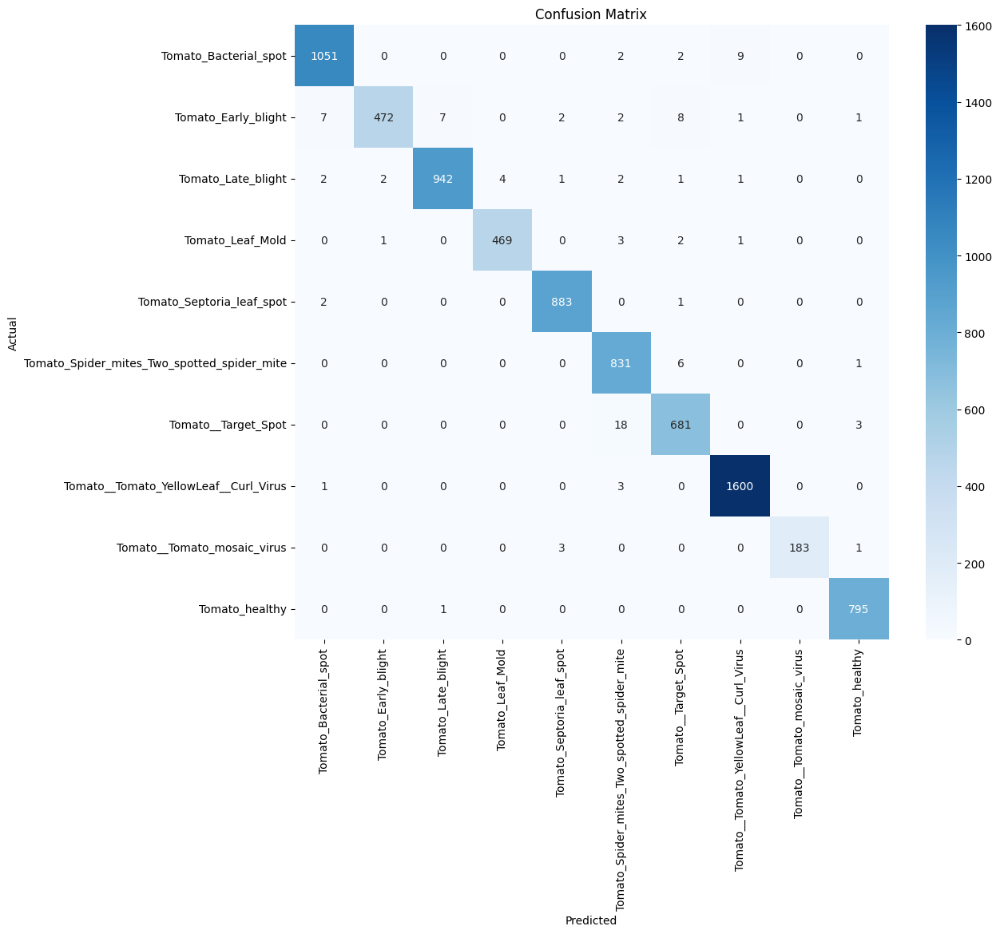

In [51]:
cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(12, 10))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=test_data.classes,
            yticklabels=test_data.classes)
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.xticks(rotation=90)
plt.show()

# **Visualize**

In [52]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import numpy as np
import time
from tqdm import tqdm
from PIL import Image

In [53]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [54]:
def visualize_feature_maps(model, image_path, layer_name="features.0"):
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    
    image = Image.open(image_path).convert("RGB")
    input_image = transform(image).unsqueeze(0).to(device)

    # Load the model
    model.eval()
    model.to(device)
    
    activation = {}
    def get_activation(name):
        def hook(model, input, output):
            activation[name] = output.detach()
        return hook

    for name, layer in model.named_modules():
        if name == layer_name:
            layer.register_forward_hook(get_activation(name))
    
    # Forward pass
    _ = model(input_image)

    # Extract feature maps
    feature_maps = activation[layer_name].squeeze(0)
    num_feature_maps = feature_maps.size(0)

    plt.figure(figsize=(15, 15))
    for i in range(min(num_feature_maps, 16)):  # Show 16 feature maps max
        plt.subplot(4, 4, i + 1)
        plt.imshow(feature_maps[i].cpu().numpy(), cmap='viridis')
        plt.axis('off')
        plt.title(f"Feature Map {i+1}")
    plt.tight_layout()
    plt.show()

In [55]:
model = models.mobilenet_v2(pretrained=True)
model.classifier[1] = nn.Linear(model.classifier[1].in_features, 10)
model.load_state_dict(torch.load("/kaggle/input/aib5-models/pytorch/default/4/Week7v1", map_location=device))

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
<ipython-input-55-2461b4536b7c>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for mor

<All keys matched successfully>

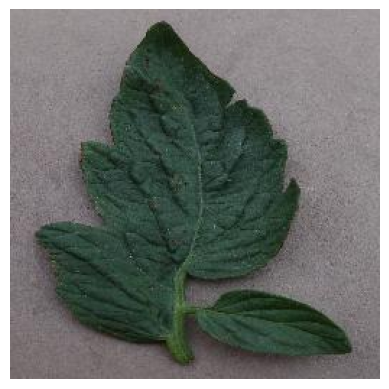

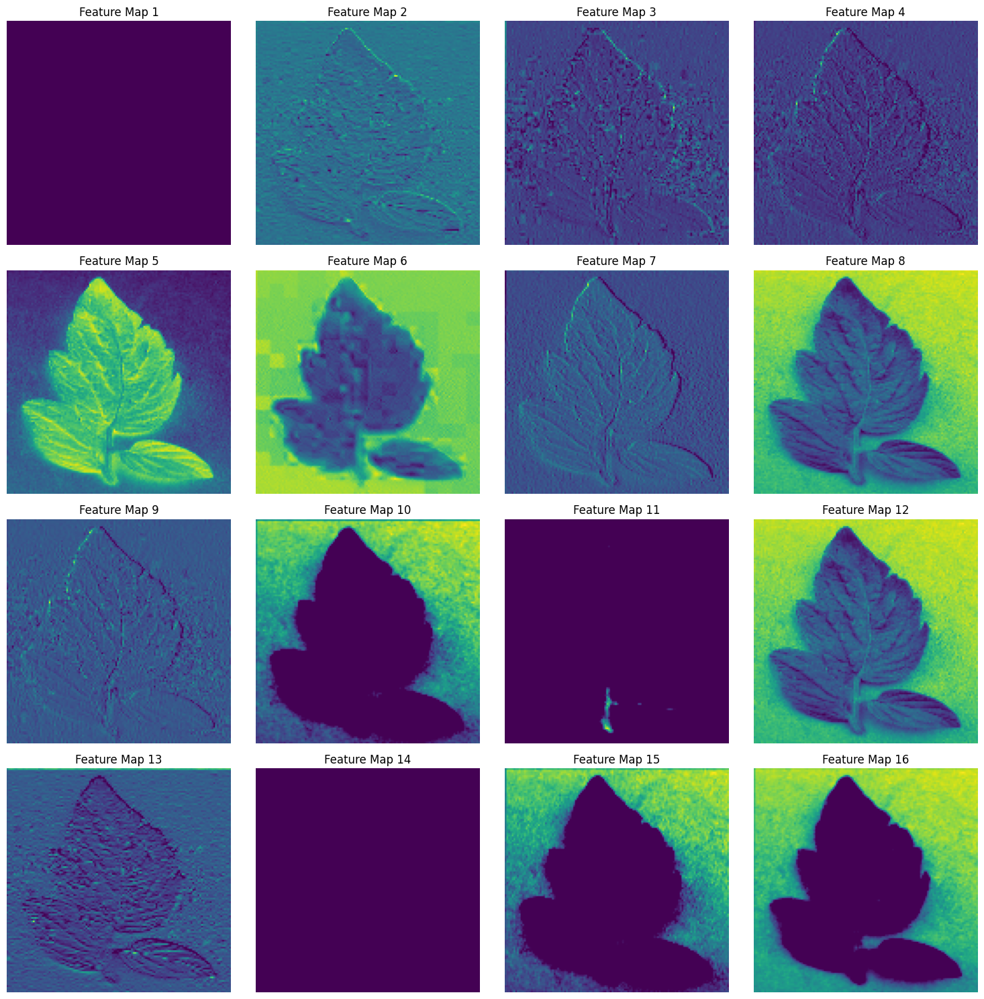

In [56]:
# Tomato Bacterial Spot
path = "/kaggle/input/plantdisease/PlantVillage/Tomato_Bacterial_spot/00416648-be6e-4bd4-bc8d-82f43f8a7240___GCREC_Bact.Sp 3110.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")

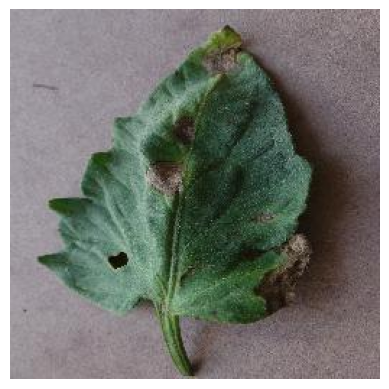

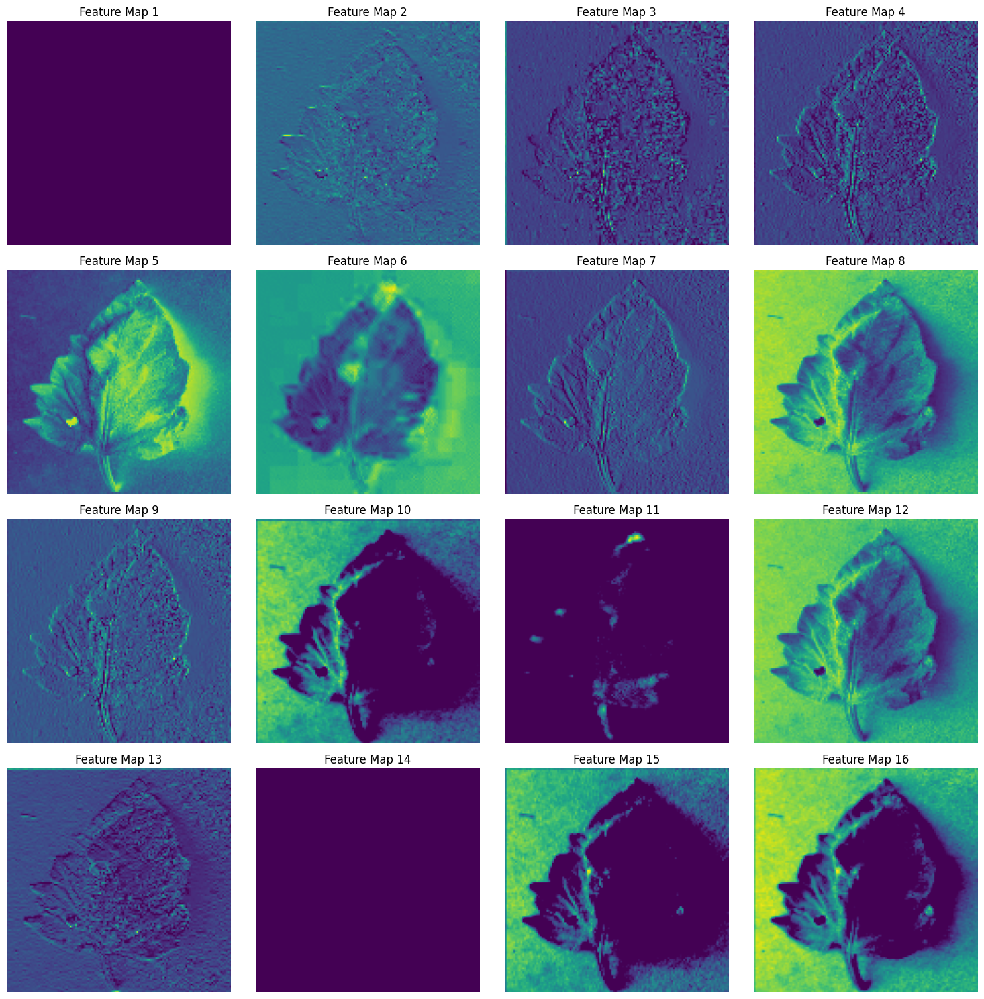

In [57]:
# Tomato Early Blight
path = "/kaggle/input/plantdisease/PlantVillage/Tomato_Early_blight/0114f7b3-7f56-4bef-aa47-7a82da142d4b___RS_Erly.B 7437.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")

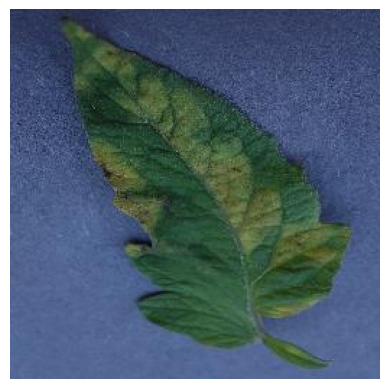

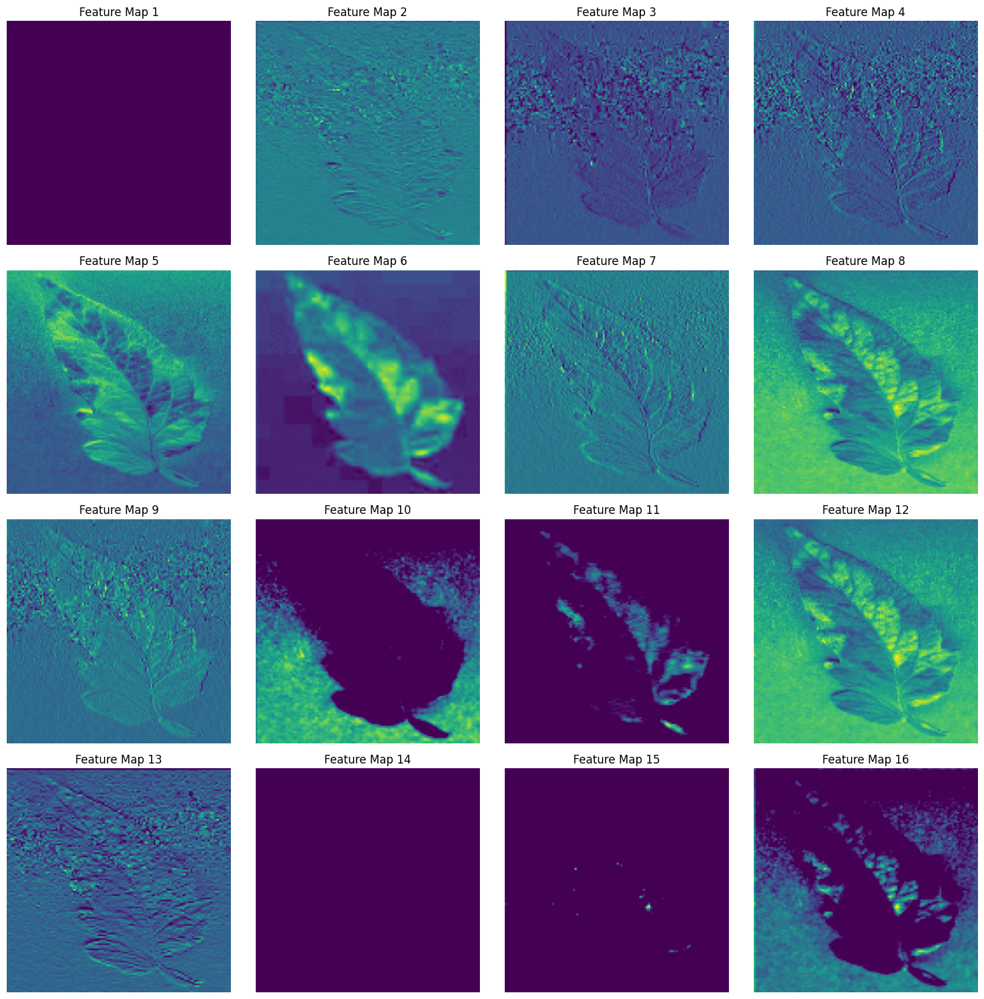

In [58]:
# Tomato Laef Mold
path = "/kaggle/input/plantdisease/PlantVillage/Tomato_Leaf_Mold/03c6374e-c292-440e-b2e3-a70c5e64562a___Crnl_L.Mold 8935.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")

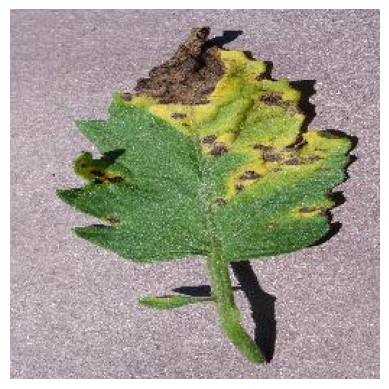

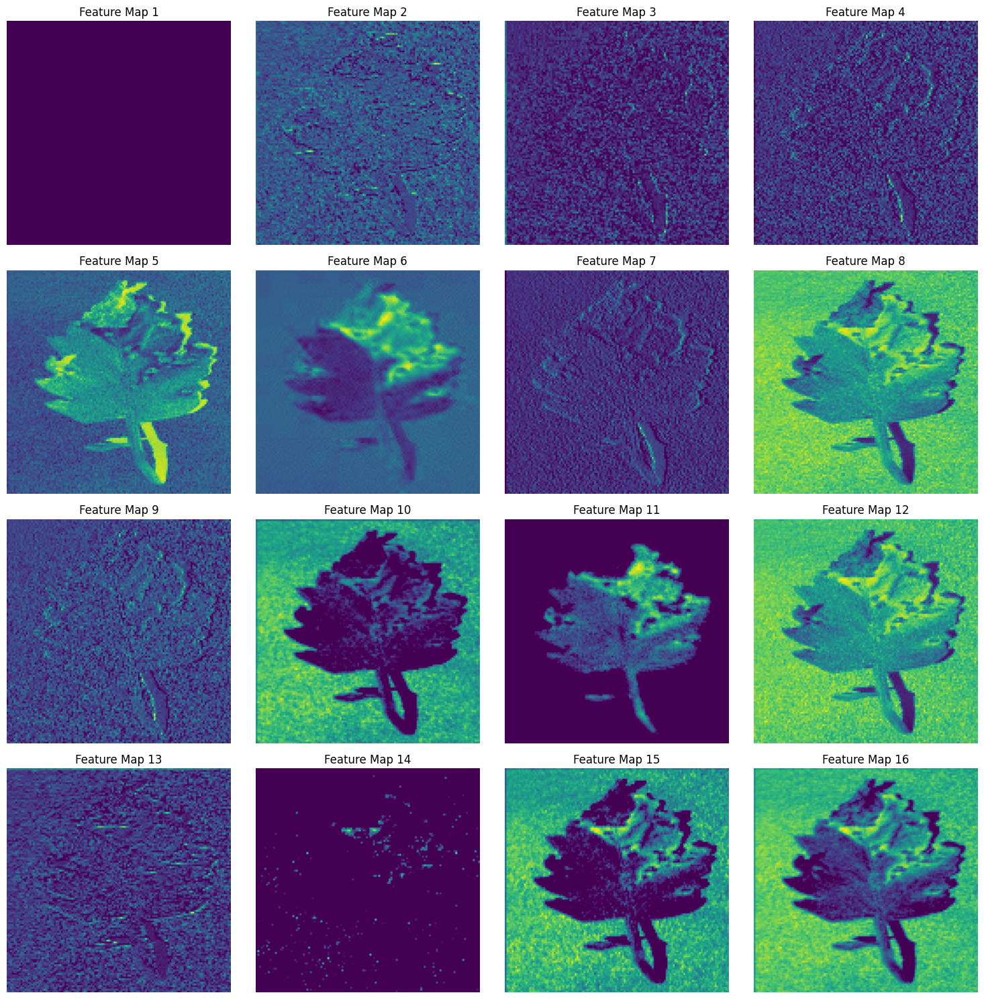

In [59]:
# Tomato Septoria Leaf Spot
path = "/kaggle/input/plantdisease/PlantVillage/Tomato_Septoria_leaf_spot/02ab6821-757a-401b-ac04-919fdceee1f0___Matt.S_CG 1653.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")

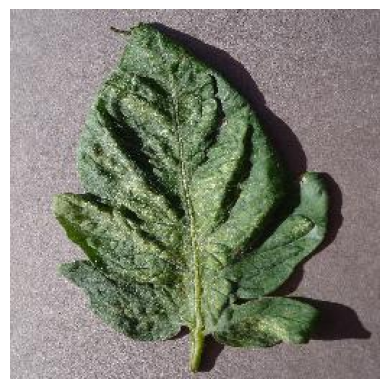

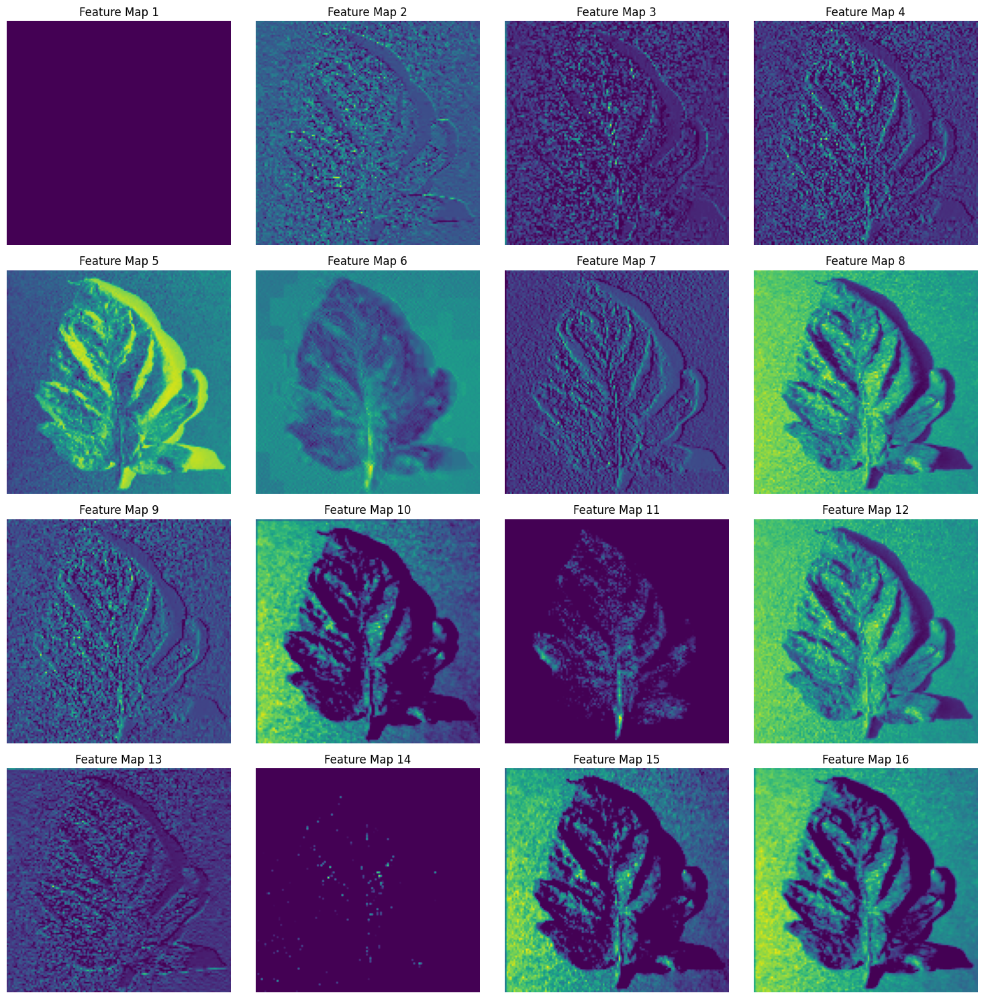

In [60]:
# Tomato Spider Mites Two Soptted Spic
path = "/kaggle/input/plantdisease/PlantVillage/Tomato_Spider_mites_Two_spotted_spider_mite/02c791ab-ffc3-40d4-9b42-db946eee2413___Com.G_SpM_FL 1640.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")

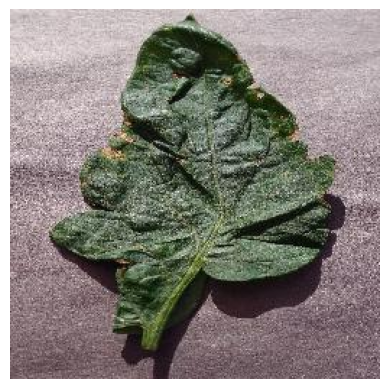

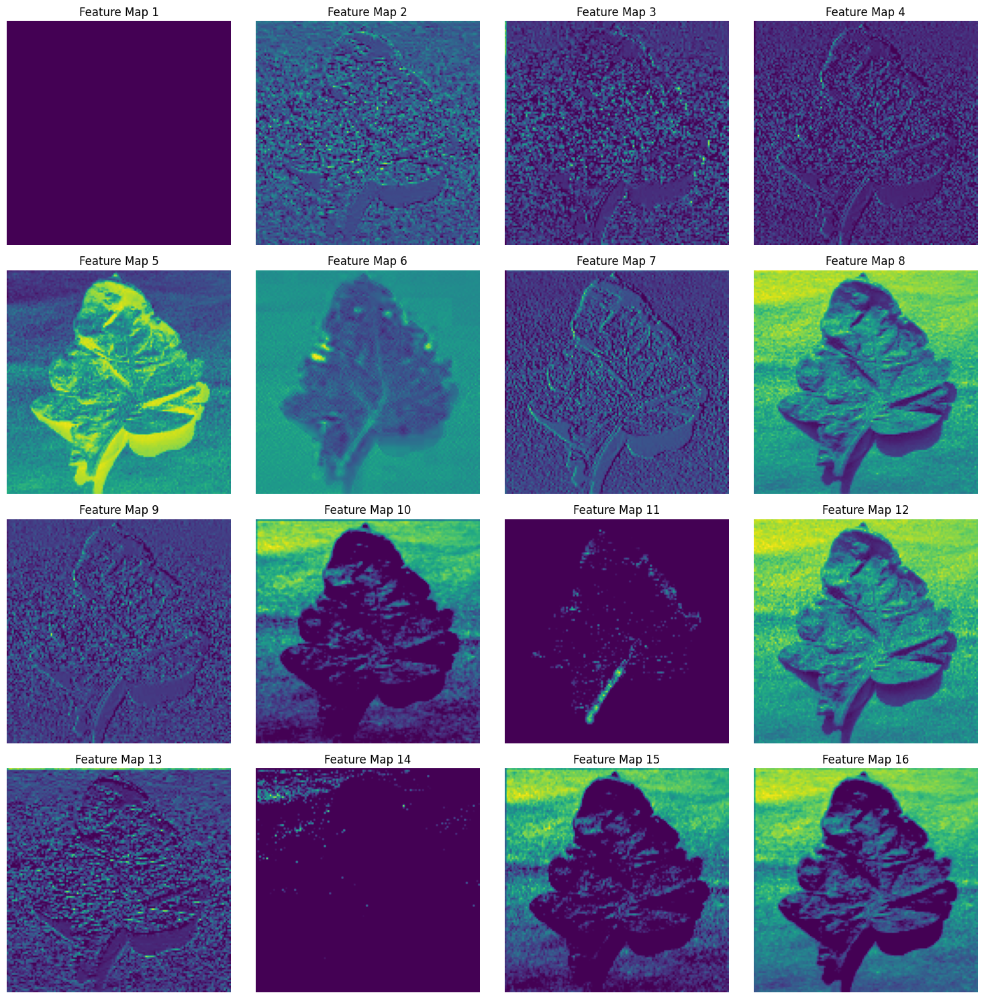

In [61]:
# Tomato Target Spot
path = "/kaggle/input/plantdisease/PlantVillage/Tomato__Target_Spot/02da8ab6-7510-4bf7-a0e3-457f14b6adad___Com.G_TgS_FL 1022.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")

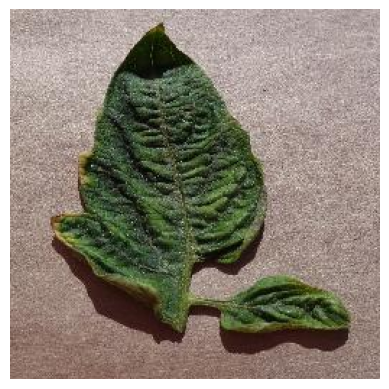

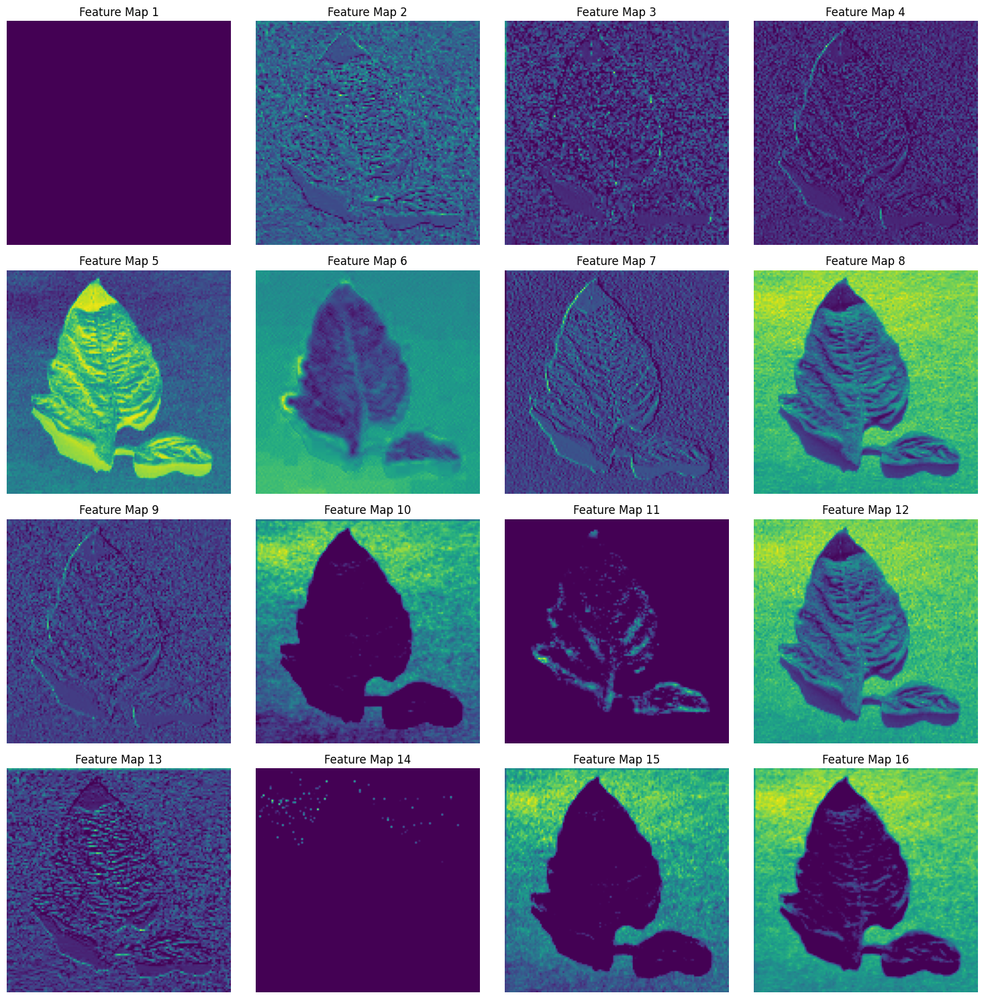

In [62]:
# Tomato Yellow Leaf Curl Virus
path = "/kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_YellowLeaf__Curl_Virus/00c16232-5beb-41a1-9a05-b18a02f10ca1___YLCV_NREC 2536.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")

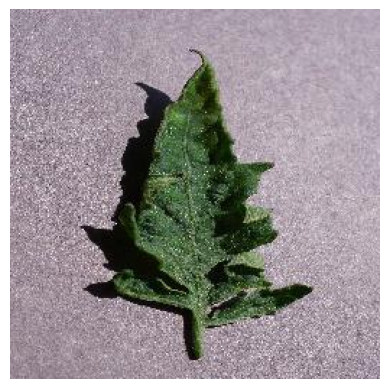

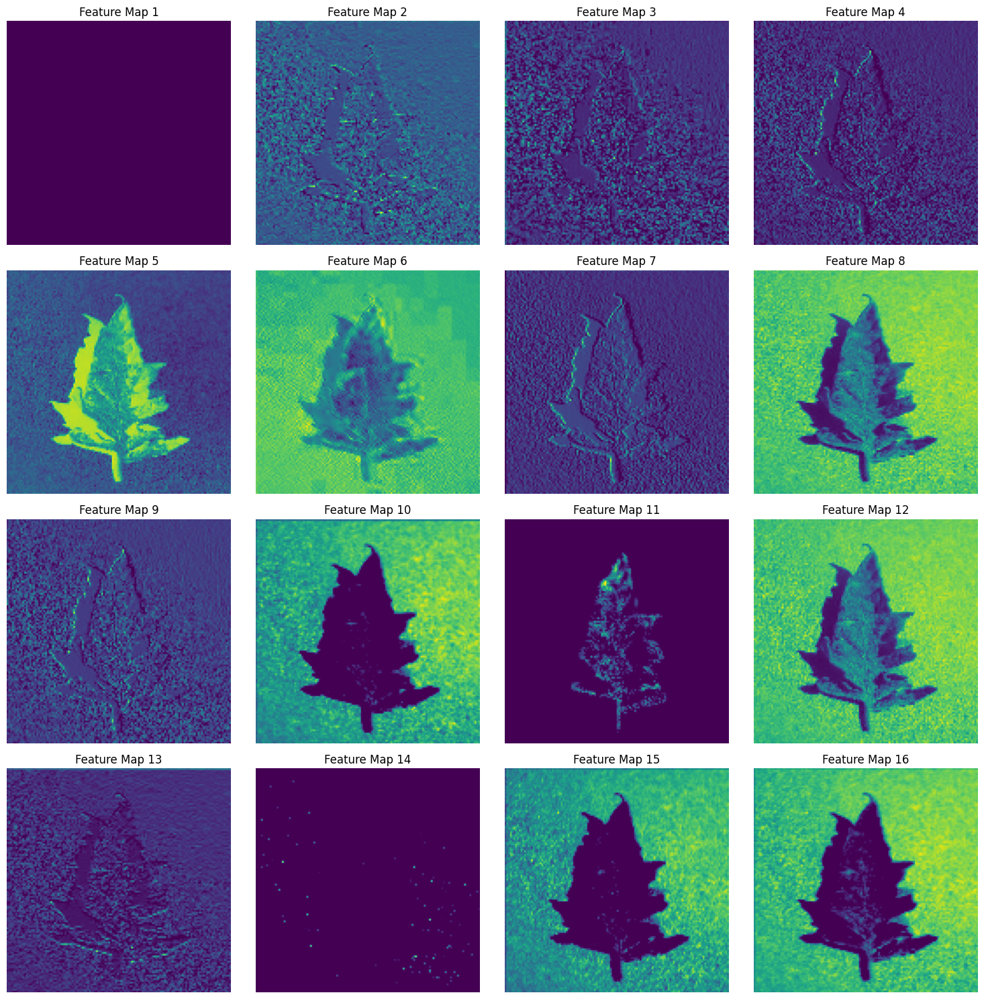

In [63]:
# Tomato Mosaic Virus
path = "/kaggle/input/plantdisease/PlantVillage/Tomato__Tomato_mosaic_virus/0fefaaee-79e4-45a6-8606-5a4ab1ea43a2___PSU_CG 2398.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")

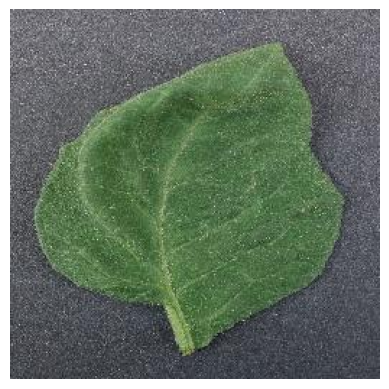

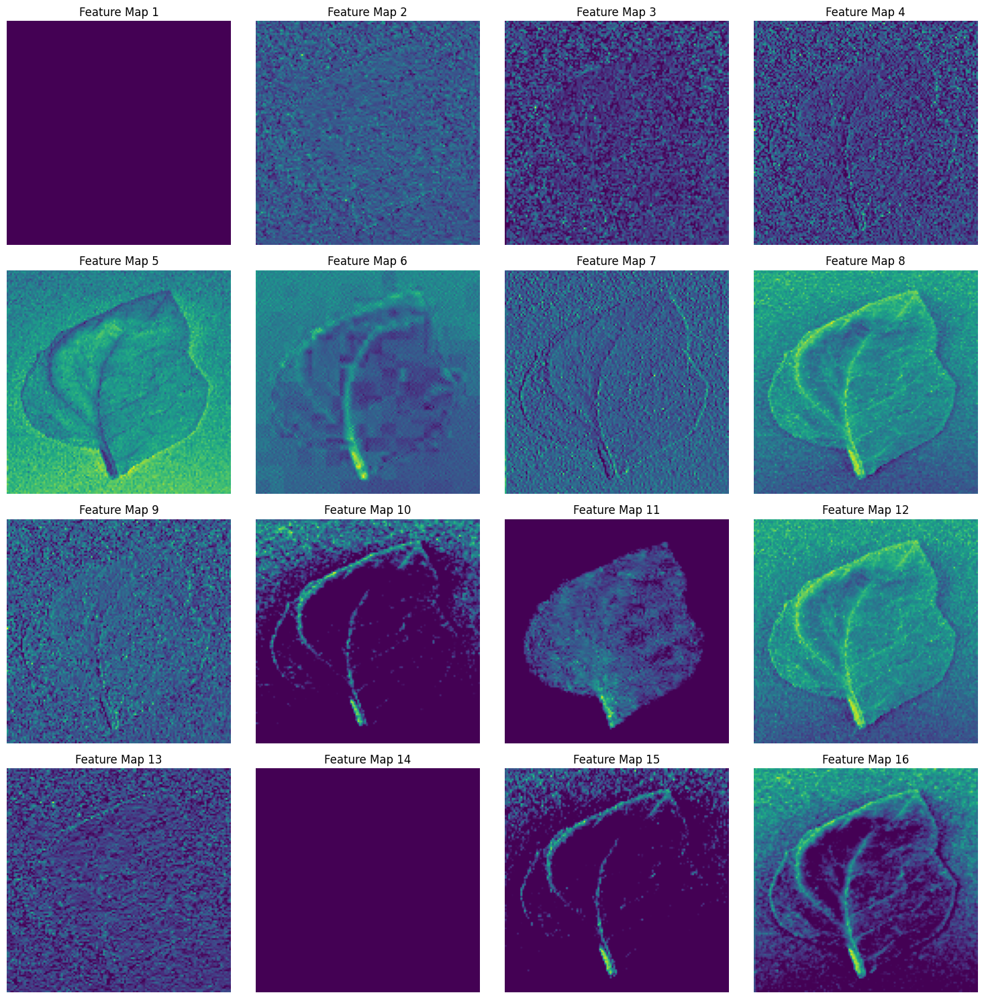

In [64]:
# Tomato Healty
path = "/kaggle/input/plantdisease/PlantVillage/Tomato_healthy/0576ef4b-c843-4dfb-b148-c917f7d605b7___GH_HL Leaf 299.JPG"
im = Image.open(path)
plt.imshow(im)
plt.axis('off')
plt.show()
visualize_feature_maps(model, path, layer_name="features.0")